#Install Dependencies



In [ ]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 6782, done.
remote: Counting objects: 100% (86/86), done.
remote: Compressing objects: 100% (58/58), done.
remote: Total 6782 (delta 49), reused 53 (delta 27), pack-reused 6696
Receiving objects: 100% (6782/6782), 8.74 MiB | 28.58 MiB/s, done.
Resolving deltas: 100% (4656/4656), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 645kB 8.2MB/s 
Setup complete. Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# Download Dataset 



In [ ]:
# Export code snippet and paste here
%cd ..
!gdown https://drive.google.com/uc?id=1BxN7hqkQWXMjHm7xuo9lVAf4XO3H1lkz

/content
Downloading...
From: https://drive.google.com/uc?id=1BxN7hqkQWXMjHm7xuo9lVAf4XO3H1lkz
To: /content/HRSID_noise.zip
636MB [00:04, 128MB/s]


In [ ]:
!unzip HRSID_noise.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/labels/P0092_600_1400_1200_2000_jpg.rf.185470eeaefc24913c3679ac0e845399.txt  
  inflating: train/labels/P0092_600_1400_1200_2000_jpg.rf.cac3aefbe7e6ac020a5701c6517094e1.txt  
  inflating: train/labels/P0092_600_1400_1200_2000_jpg.rf.daccdccf5e50b21c273fa3cf754e7767.txt  
  inflating: train/labels/P0092_600_1400_3000_3800_jpg.rf.0904c21816743ddf79d94d6d1346f412.txt  
  inflating: train/labels/P0092_600_1400_3000_3800_jpg.rf.6283683007de862a185ea94883bbad63.txt  
  inflating: train/labels/P0092_600_1400_3000_3800_jpg.rf.ef3acec20084d5b280adf2ea1bf100cc.txt  
  inflating: train/labels/P0093_0_800_0_800_jpg.rf.65d1e17ab69843c265b90b919b1037b9.txt  
  inflating: train/labels/P0093_0_800_0_800_jpg.rf.b48a47ed3c7c91fd9892e46bcb94e843.txt  
  inflating: train/labels/P0093_0_800_0_800_jpg.rf.de8e591c9ab160917e68cc09031c50c0.txt  
  inflating: train/labels/P0093_0_800_1200_2000_jpg.rf.5c769cbcfe4bb3055551de6b0884e795.txt  
  i

In [ ]:

%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['ship']

# Define Model Configuration and Architecture




In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use 
%cat /content/yolov5/models/yolov5s.yaml

In [ ]:

from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.32  # model depth multiple
width_multiple: 0.24  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  
  - [30,61, 62,45, 59,119]  
  - [116,90, 156,198, 373,326]  

# YOLOv5 backbone
backbone:

  [[-1, 1, Focus, [64, 3]],  
   [-1, 1, Conv, [128, 3, 2]], 
   [-1, 1, Conv, [256, 3, 2]],  
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]], 
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  
   [-1, 3, C3, [512, False]],  

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  
   [-1, 3, C3, [256, False]],  

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]], 
   [-1, 3, C3, [512, False]], 

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  
   [-1, 3, C3, [1024, False]],  

   [[17, 20, 23], 1, Detect, [nc, anchors]],  
  ]



# Train Custom YOLOv5 Detector

### Next, we'll fire off training!




In [ ]:
# train yolov5s on custom data for 60 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 60 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache 

/content/yolov5
github: ⚠️ WARNING: code is out of date by 186 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../data.yaml', device='', entity=None, epochs=60, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results2', single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
wandb: Install Weights & Biases for YOLOv5 logging with 'pip install wandb' (recommended)
Start Tensorboard with "tensorboard --logd

# Evaluate Custom YOLOv5 Detector Performance

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

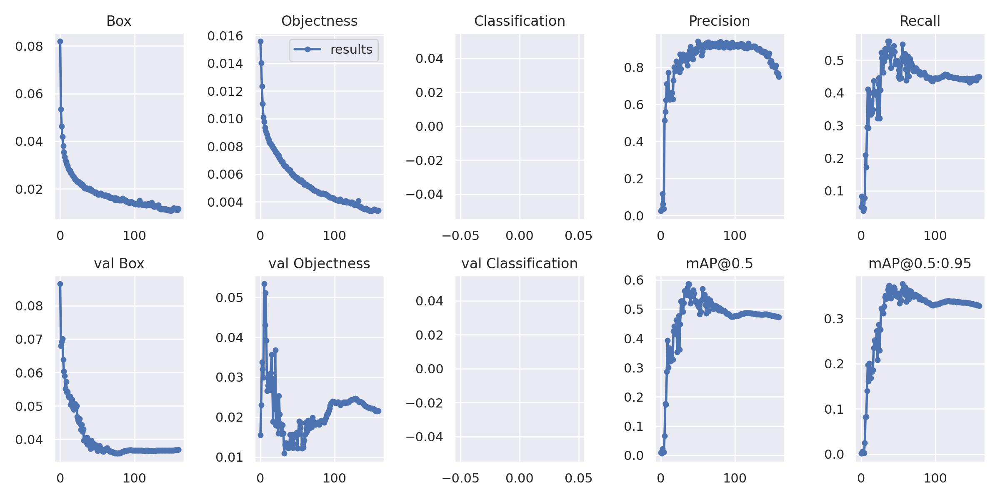

In [ ]:
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)  

### Curious? Visualize Our Training Data with Labels



GROUND TRUTH TRAINING DATA:


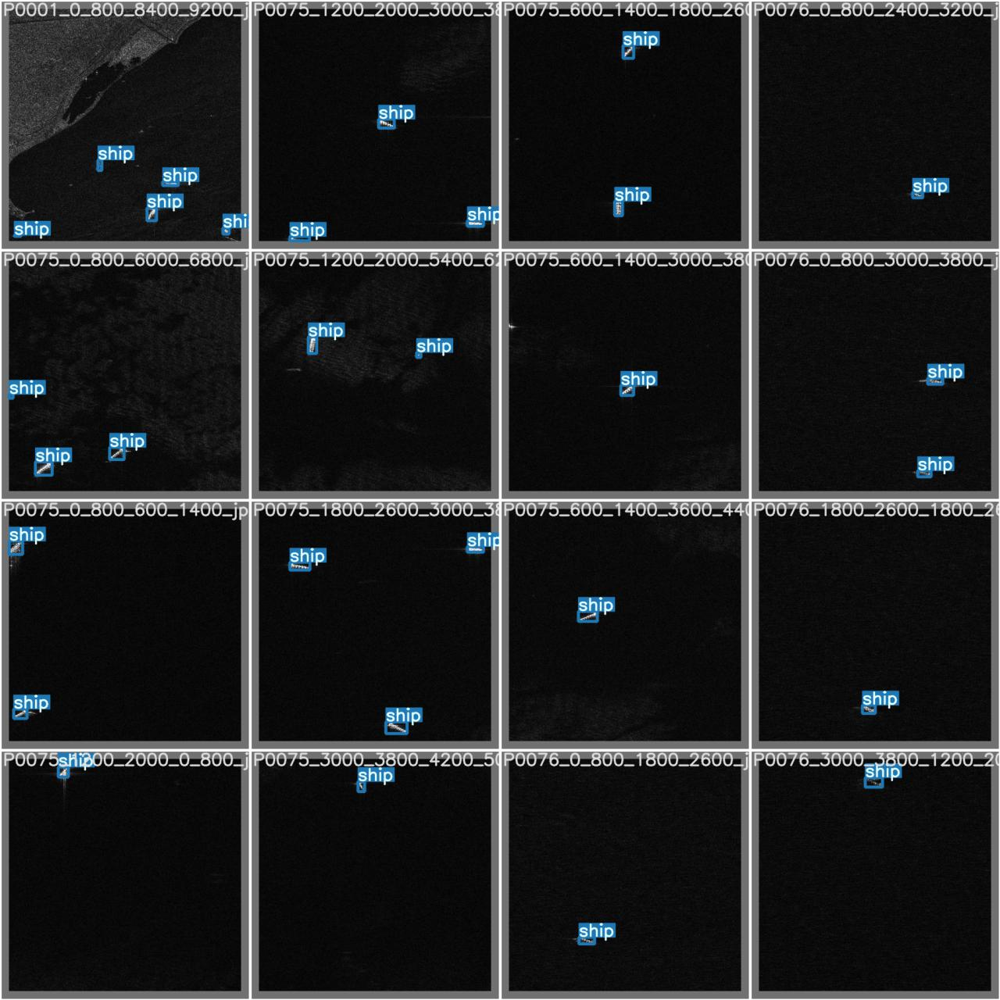

In [ ]:

print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


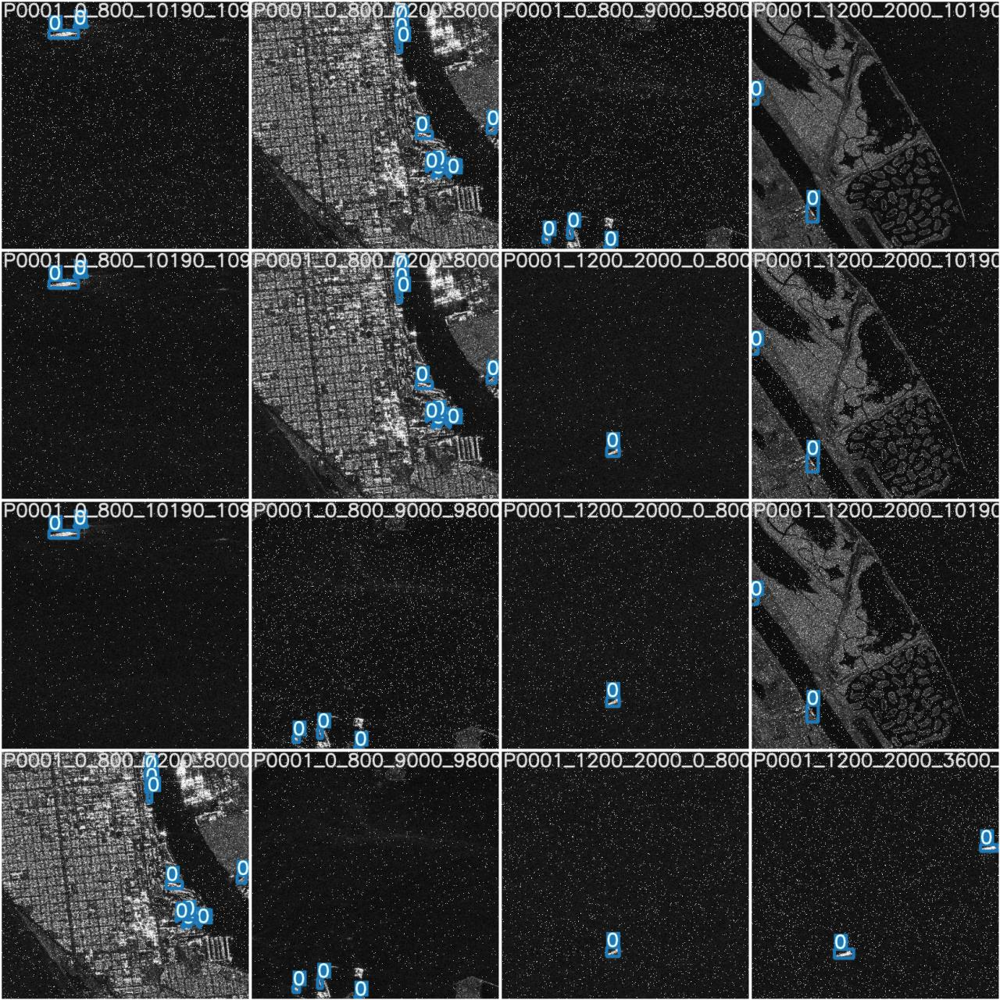

In [ ]:

print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights


In [ ]:
# trained weights are saved by in our weights folder
%ls runs/

yolov5s_results/


In [ ]:
%ls runs/train/yolov5s_results/weights

ls: cannot access 'runs/train/yolov5s_results/weights': No such file or directory


In [ ]:
# use the best weights
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images --save-txt

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=True, source='../test/images', update=False, view_img=False, weights=['best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 224 layers, 1715986 parameters, 0 gradients, 4.2 GFLOPS
image 1/560 /content/yolov5/../test/images/P0001_0_800_9600_10400_jpg.rf.4bb2d5901ecb2c1b0d892081a88cc02d.jpg: 416x416 1 ship, Done. (0.017s)
image 2/560 /content/yolov5/../test/images/P0001_3000_3800_7200_8000_jpg.rf.3c9fd8e3b627620b0fca0baef2fffc7d.jpg: 416x416 2 ships, Done. (0.007s)
image 3/560 /content/yolov5/../test/images/P0001_4800_5600_0_800_jpg.rf.d476702d79b077959b6ee2717cb001f6.jpg: 416x416 1 ship, Done. (0.007s)
image 4/560 /content/yolov5/../test/images/P0001_4800_5600_3000_3800_jpg.rf.27f5d22b1ef108bdd60a0898867999ce.jpg: 416

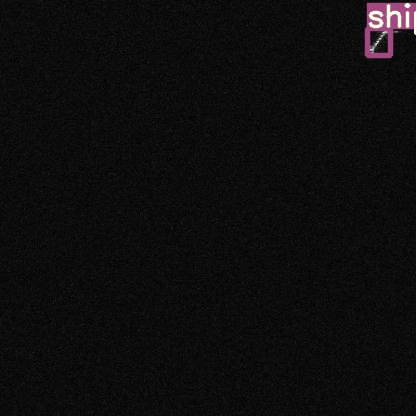

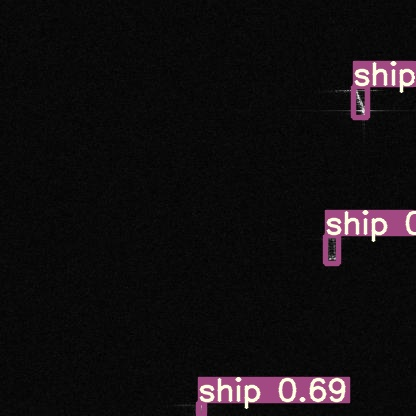

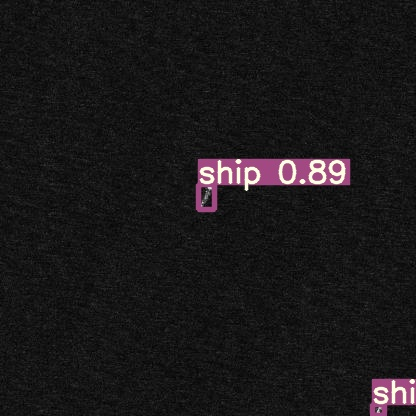

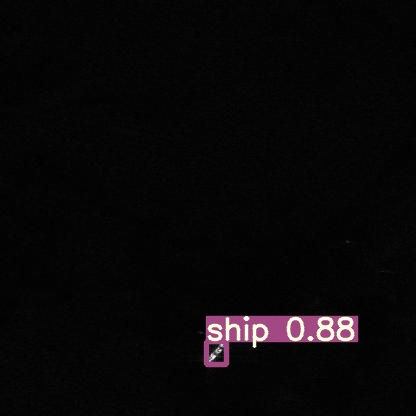

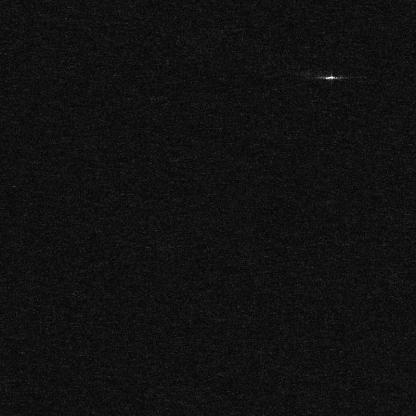

...

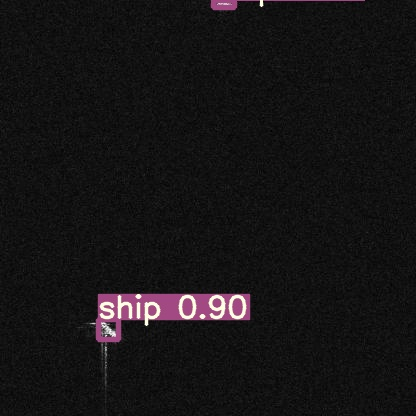

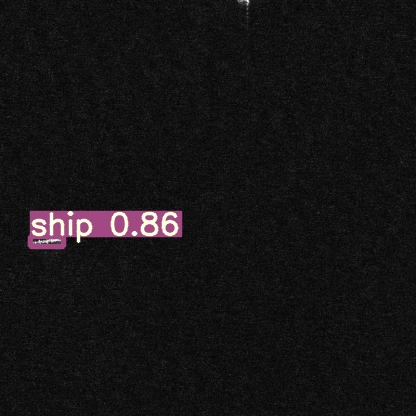

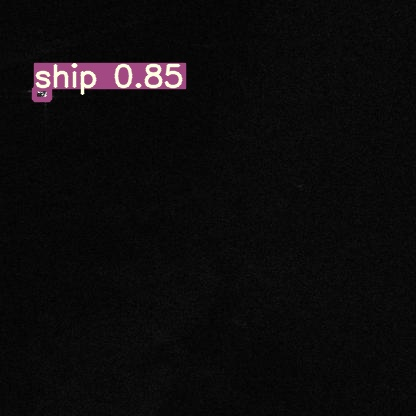

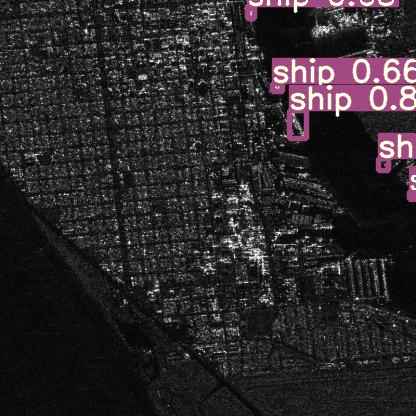

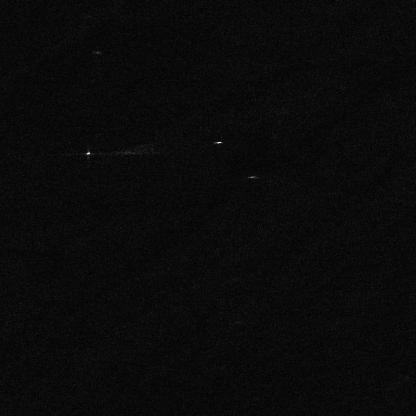

In [ ]:
#display inference on ALL test images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
%cd runs/detect/exp/labels


/content/yolov5/runs/detect/exp/labels


In [ ]:
import os
def calc_size(w,h):
    w1 = w*416
    h1= h*416
    size = w1*h1
    return size
def calc_location(x,y):
    #Lattitude and Longitude
    BL_lat = 46.6758
    BL_long= 75.8976
    TR_lat = 56.9850
    TR_long= 88.2564
    long_diff = TR_long-BL_long
    lat_diff = TR_lat -BL_lat   
    x1=x*long_diff
    y1=y*lat_diff
    return x1,y1
def size_and_location(file_name):
    fp=open(file_name,"r")
    i=0
    s=[]
    y1=[]
    for line in fp:
        ln=line.split(" ")
        x=float(ln[1])
        y=float(ln[2])
        w=float(ln[3])
        h=float(ln[4])
        s.append( calc_size(w,h))
        x1.append(0)
        y1.append(0)
        x1[i],y1[i] = calc_location(x,y)
        i+=1
    fp.close()

    fp=open(file_name,"a")
    fp.write("\n")
    for i in range(len(s)):
        fp.write("\n")
        fp.write("Size : "+str(s[i])+"\n")
        fp.write("Location : "+str(x1[i])+","+str(y1[i])+"\n")
    fp.close()

file_names=os.listdir()
print (file_names)
for file_name in file_names:
    size_and_location(file_name)




['P0055_600_1400_1800_2600_jpg.rf.0cae637a953980b6c5f56df65f3116d7.txt', 'P0137_46_jpg.rf.c2843076722bcd79c6b653c6f06b5fd5.txt', 'P0090_2200_3000_3600_4400_jpg.rf.fcef8a0f10ed847f4a4f8d44544b8c0a.txt', 'P0128_3600_4400_4200_5000_jpg.rf.aa0b9d3f2568edf58e707ac7ae651b2d.txt', 'P0003_4200_5000_3600_4400_jpg.rf.576a4a63a4fad5435b94cfbc9a6cc308.txt', 'P0080_3600_4400_3000_3800_jpg.rf.436fdead19406d0b50584ff060eb71c1.txt', 'P0028_2400_3200_3000_3800_jpg.rf.7b743e8c9710e19dc3bfa766f2202adb.txt', 'P0001_0_800_9600_10400_jpg.rf.4bb2d5901ecb2c1b0d892081a88cc02d.txt', 'P0056_0_800_5400_6200_jpg.rf.bf729772d68910864c940860ca8ebd8e.txt', 'P0078_4700_5500_3000_3800_jpg.rf.36aec125bfeacbf718d449171de96c2c.txt', 'P0036_1200_2000_5400_6200_jpg.rf.a08b0f07e3135fd433b1831ff392ff8b.txt', 'P0131_7200_8000_1200_2000_jpg.rf.92ce5d4a21e8bd62e57d2d8236c36ff1.txt', 'P0033_3000_3800_3000_3800_jpg.rf.b2d6004fa9b923badd89873d902ebc33.txt', 'P0126_5400_6200_10800_11600_jpg.rf.21682984ccee6f165f57e1467b99e00d.txt', 